**Brian Blaylock**  
**September 26, 2019**

# GOES ABI RGB Recipes

For details on the RGB recipies below see  the [RAMMB CIRA](http://rammb.cira.colostate.edu/training/visit/quick_guides/) website
for GOES-R, including:

- TrueColor
- FireTemperature
- AirMass
- DayCloudPhase
- DayConvection
- DayLandCloudFire
- WaterVapor
- DaySnowFog
- etc.

These recipies are provided by the `rgb` custom accessor. This accessor is avaialble when you import goes2go.


## Simple RGB Figure
At the most simple level, here is how to produce an RGB from the GOES ABI data.

In [1]:
from goes2go.data import goes_nearesttime
import matplotlib.pyplot as plt 
from datetime import datetime
from pathlib import Path
import xarray

/Users/phil/mini310/envs/a301/lib/python3.13/site-packages/goes2go/data.py:673: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  within=pd.to_timedelta(config["nearesttime"].get("within", "1h")),
/Users/phil/mini310/envs/a301/lib/python3.13/site-packages/goes2go/NEW.py:185: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  within=pd.to_timedelta(config["nearesttime"].get("within", "1h")),


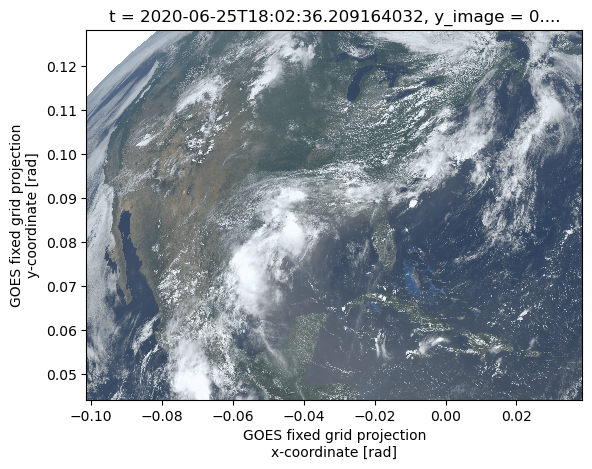

In [19]:
# Get an ABI Dataset
save_dir = Path.home() / "repos/a301/satdata/goes" 
writeit = False
if writeit:
    g = goes_nearesttime(
        datetime(2020, 6, 25, 18), satellite="goes16",product="ABI-L2-MCMIP", domain='C', 
          return_as="xarray", save_dir = save_dir, download = True, overwrite = False
    )
    the_path = g.path[0]
else:
    the_path = ("noaa-goes16/ABI-L2-MCMIPC/2020/177/18/"
                "OR_ABI-L2-MCMIPC-M6_G16_s20201771801172_e20201771803551_c20201771804104.nc")
    full_path = save_dir / the_path
    g = xarray.open_dataset(full_path,mode = 'r',mask_and_scale = True)
# Create RGB and plot
image = g.rgb.TrueColor()
image.plot.imshow();

## Cartopy RGB Figure
The RGB can easily be added to a Cartopy axis

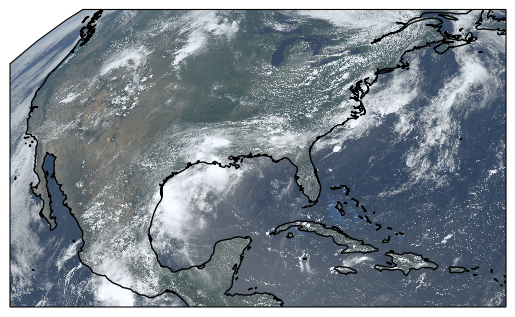

In [3]:
ax = plt.subplot(projection=g.rgb.crs)
ax.imshow(g.rgb.TrueColor(), **g.rgb.imshow_kwargs)
ax.coastlines()

### keywords for cartopy plotting

In [4]:
g.rgb.imshow_kwargs

{'extent': [np.float64(-3626269.332309611),
  np.float64(1381769.9431296065),
  np.float64(1584175.830644913),
  np.float64(4588197.756226748)],
 'transform': <Projected CRS: +proj=geos +a=6378137.0 +b=6356752.31414 +rf=298.2 ...>
 Name: unknown
 Axis Info [cartesian]:
 - E[east]: Easting (metre)
 - N[north]: Northing (metre)
 Area of Use:
 - undefined
 Coordinate Operation:
 - name: unknown
 - method: Geostationary Satellite (Sweep X)
 Datum: Unknown based on GRS 1980 ellipsoid
 - Ellipsoid: GRS 1980
 - Prime Meridian: Greenwich,
 'origin': 'upper',
 'interpolation': 'none'}

## All available RGB recipes

In [5]:
from goes2go.data import goes_nearesttime
import cartopy.crs as ccrs
import matplotlib.pyplot as plt


In [18]:
writeit = False
if writeit:
    G16 = goes_nearesttime('2024-06-25 18',satellite=16,save_dir=save_dir)
    print(G16.path[0])
else:
    the_path = ("noaa-goes16/ABI-L2-MCMIPC/2024/177/18"
                "/OR_ABI-L2-MCMIPC-M6_G16_s20241771801172_e20241771803557_c20241771804062.nc")
    full_path = save_dir / the_path
    G16 = xarray.open_dataset(full_path,mode = 'r',mask_and_scale = True)
if writeit:
    G18 = goes_nearesttime('2024-06-25 18',satellite=18,save_dir=save_dir)
    print(G18.path[0])
else:
    the_path = ("noaa-goes16/ABI-L2-MCMIPC/2024/177/18"
                "/OR_ABI-L2-MCMIPC-M6_G16_s20241771801172_e20241771803557_c20241771804062.nc")
    full_path = save_dir / the_path
    G18 = xarray.open_dataset(full_path,mode = 'r',mask_and_scale = True)

/Users/phil/mini310/envs/a301/lib/python3.13/site-packages/goes2go/accessors.py:1251: UserWarning: THE `NormalizedBurnRatio` FUNCTION IS NOT FULLY DEVELOPED. NEED MORE INFO.
  warnings.warn(
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.757256..1.0].
/Users/phil/mini310/envs/a301/lib/python3.13/site-packages/goes2go/accessors.py:1251: UserWarning: THE `NormalizedBurnRatio` FUNCTION IS NOT FULLY DEVELOPED. NEED MORE INFO.
  warnings.warn(
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.49068323..1.0].
/var/folders/h3/5svt7fds58v0x7kkc54kl3640000gn/T/ipykernel_57551/210842163.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_w

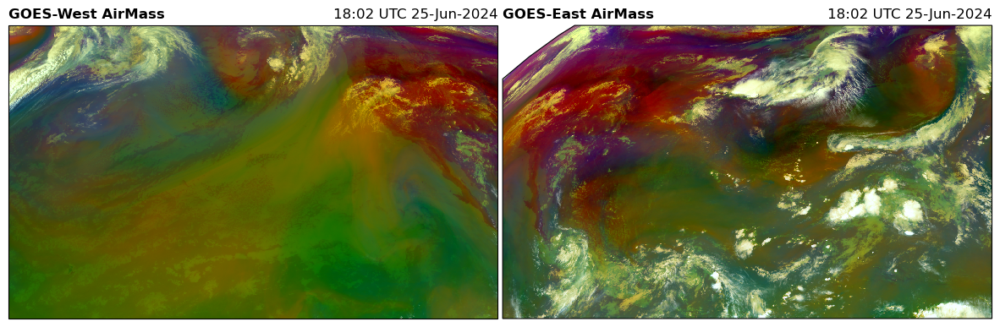

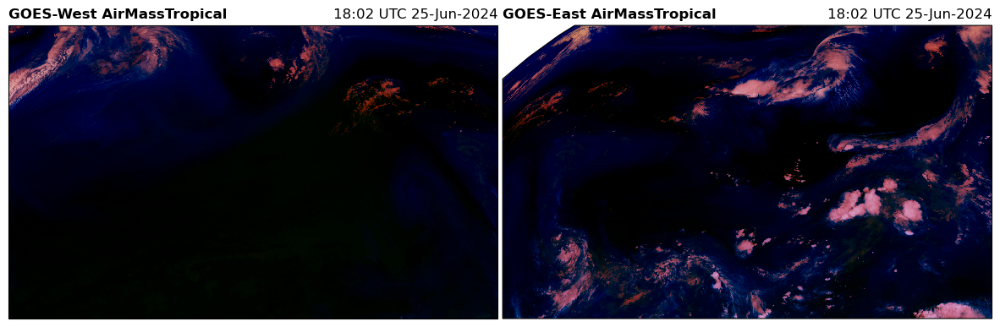

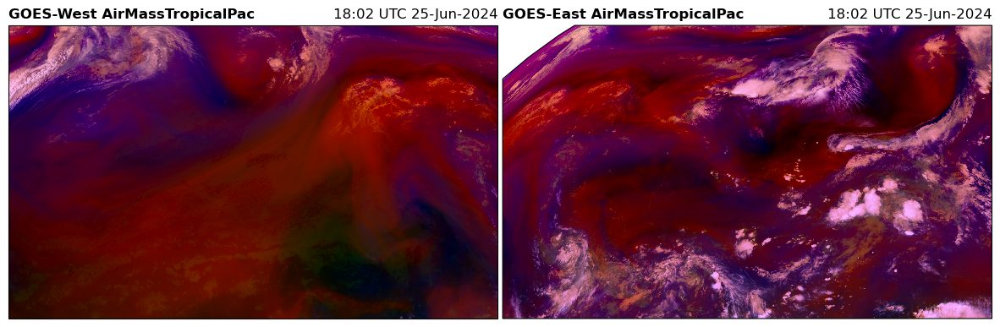

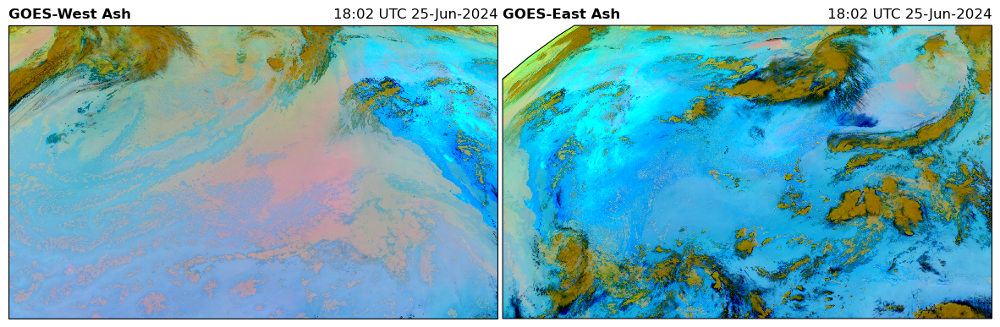

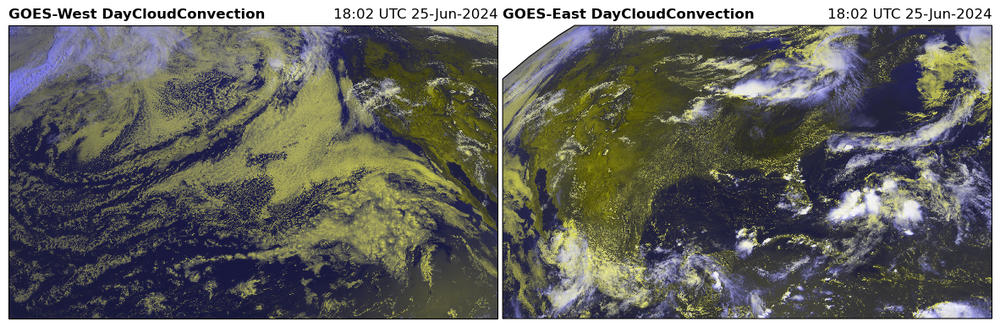

...

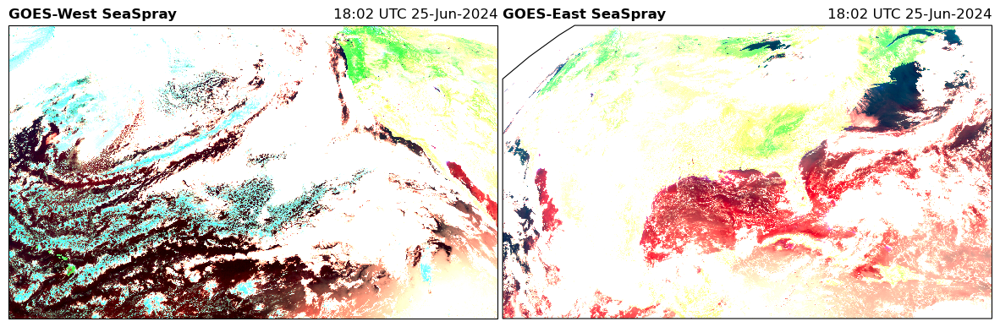

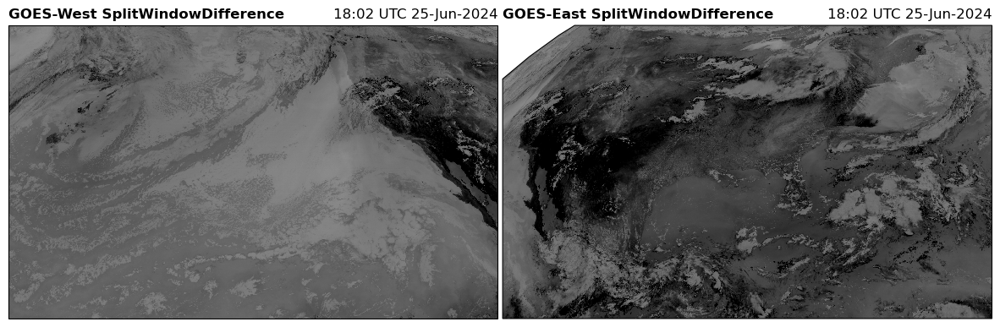

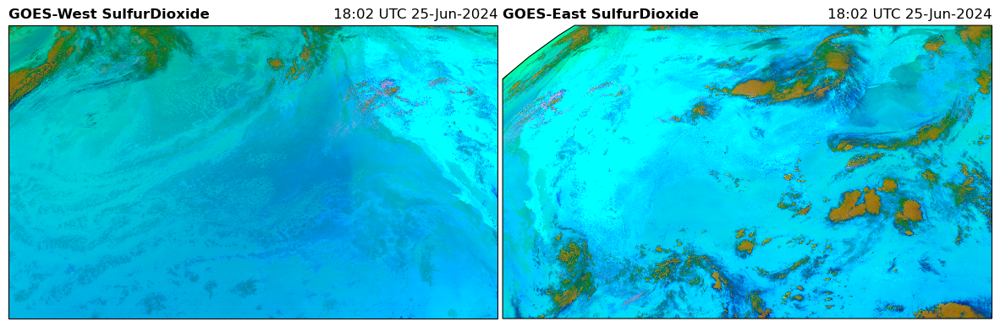

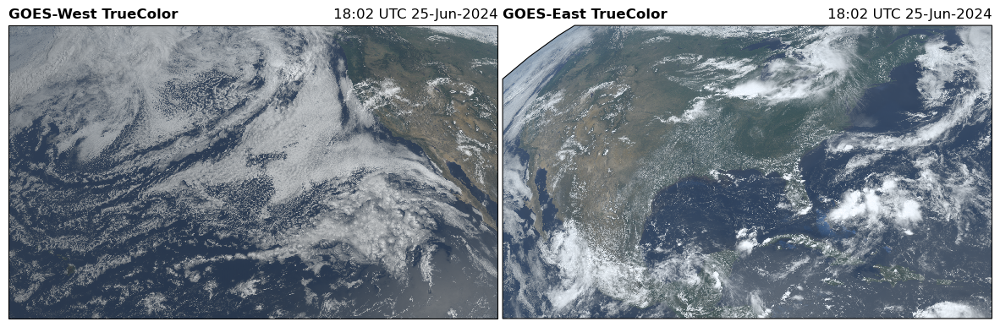

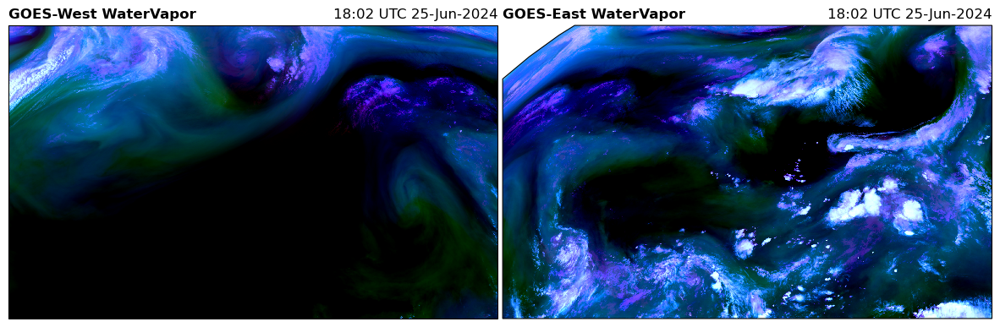

In [16]:
rgb_products = [i for i in dir(G16.rgb) if i[0].isupper()]

for product in rgb_products:

    fig = plt.figure(figsize=(15, 12))
    ax18 = fig.add_subplot(1, 2, 1, projection=G18.rgb.crs)
    ax16 = fig.add_subplot(1, 2, 2, projection=G16.rgb.crs)

    for ax, G in zip([ax18, ax16], [G18, G16]):
        RGB = getattr(G.rgb, product)()

        #common_features('50m', STATES=True, ax=ax)
        ax.imshow(RGB, **G.rgb.imshow_kwargs)
        ax.set_title(f"{G.orbital_slot} {product}", loc='left', fontweight='bold')
        ax.set_title(f"{G.t.dt.strftime('%H:%M UTC %d-%b-%Y').item()}", loc="right")
    plt.subplots_adjust(wspace=0.01)
    #plt.savefig(f'../docs/_static/{product}', bbox_inches='tight')